# Surprise storms

On Thursday at 12pm we will ask you to evaluate your models on 10 new storms for each task, released then.

By Friday 12pm, you need to provide:

1. A Jupyter notebook presenting your results and justifying your predictions on these surprise storms.
2. A set of 10 numpy files (.npy) for each task, containing your 10 storm predictions. These files will be used to rank the teams in a competition for the best prediction for each task (using L1 (absolute) error).

This notebook explains:
1. how to access the surprise data.
2. what the format of the numpy prediction files should be.
> IMPORTANT: use the submission checker function below to check your numpy files are the correct submission format, before uploading! If your files do not pass, **your predictions won't be included in the final ranking!**
>
> Upload your final predictions to your team folder here: https://imperiallondon-my.sharepoint.com/:f:/g/personal/bm1417_ic_ac_uk/Et_sPeZqVCVAk9r7waf4p7kBsxCkmkT5gexrhFS45QphAw?e=fCKWui

# 1. How to access the surprise data

The data will be uploaded to huggingface on Thursday.

There is a .csv file and .h5 file *for each task*.

The .csv and .h5 files for each task have *exactly the same format and structure* as the training data (events.csv and train.h5), *except that some of the data is missing in the .h5 file (the data you must predict for each task)*.

Use the code below to download the surprise data.

In [5]:
from huggingface_hub import hf_hub_download
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_task1.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_task2.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_task3.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_events1.csv", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_events2.csv", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="surprise_events3.csv", repo_type="dataset", local_dir="data")


'data/surprise_events3.csv'

In [6]:
import pandas as pd
import h5py
import numpy as np

# example reading in the csv for surprise task 2
df = pd.read_csv("data/surprise_events2.csv", parse_dates=["start_utc"])
print(f"Number of unique events: {len(df.id.unique())}")
df.head()

Number of unique events: 10


,id,img_type,start_utc,llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon,proj,height_m,width_m
0,S852507,ir069,2019-08-01 18:54:00+00:00,33.801819,-84.174608,36.590323,-79.277599,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
1,S852507,ir107,2019-08-01 18:54:00+00:00,33.801819,-84.174608,36.590323,-79.277599,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
2,S852507,lght,NaT,33.801819,-84.174608,36.590323,-79.277599,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3,S852507,vil,2019-08-01 18:55:00+00:00,33.801819,-84.174608,36.590323,-79.277599,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
4,S852507,vis,2019-08-01 18:54:00+00:00,33.801819,-84.174608,36.590323,-79.277599,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0


In [7]:
with h5py.File(f'data/surprise_task1.h5','r') as f:
    event = {img_type: f["S844398"][img_type][:] for img_type in ['vis', 'ir069', 'ir107', 'vil']}
for img_type in event:
    print(f"{img_type}: {event[img_type].shape} ({event[img_type].dtype})")
print()
# note: surprise_task1 has only 12 frames - you need to predict the 12 next "vil" frames.

with h5py.File(f'data/surprise_task2.h5','r') as f:
    event = {img_type: f["S852507"][img_type][:] for img_type in ['vis', 'ir069', 'ir107']}
for img_type in event:
    print(f"{img_type}: {event[img_type].shape} ({event[img_type].dtype})")
print()
# note: surprise_task2 has the "vil" image missing - you need to predict it.

with h5py.File(f'data/surprise_task3.h5','r') as f:
    event = {img_type: f["S844280"][img_type][:] for img_type in ['vis', 'ir069', 'ir107', 'vil']}
for img_type in event:
    print(f"{img_type}: {event[img_type].shape} ({event[img_type].dtype})")
# note: surprise_task3 has the "lght" array missing - you need to predict it.

vis: (384, 384, 12) (int16)
ir069: (192, 192, 12) (int16)
ir107: (192, 192, 12) (int16)
vil: (384, 384, 12) (uint8)

vis: (384, 384, 36) (int16)
ir069: (192, 192, 36) (int16)
ir107: (192, 192, 36) (int16)

vis: (384, 384, 36) (int16)
ir069: (192, 192, 36) (int16)
ir107: (192, 192, 36) (int16)
vil: (384, 384, 36) (uint8)


# 2. What the format the numpy prediction files should be

You should upload 10 numpy arrays for each of the 4 tasks, containing your 10 storm predictions. Each array of each task should use the following filename and shape:

| Task      | Filename                     | Numpy Array Shape   | dtype |
|-----------|------------------------------|---------------------| |
| task 1a   | `<team-name>-task1a-vil-<storm-id>.npy` | (384, 384, 12)      | float32 |
| task 1b   | `<team-name>-task1b-vil-<storm-id>.npy` | (384, 384, 12)      | float32 |
| task 2    | `<team-name>-task2-vil-<storm-id>.npy`  | (384, 384, 36)      | float32 |
| task 3    | `<team-name>-task3-lght-<storm-id>.npy` | (N, 3)              | float32 |

> IMPORTANT: each `lght` array for task 3 should have 3 columns, where column 0 = time in seconds, column 1 = vil pixel x, column 2 = vil pixel y. The number of rows (lightning flashes), N, for each array can vary and is up to your model.


IMPORTANT: use the submission checker function below to check your numpy files are the correct submission format, before uploading! If not, **your predictions won't be included in the final ranking!**


In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Task 2

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
import h5py
import pandas as pd
import random
from scipy.ndimage import zoom
import torch.nn as nn
import torch.optim as optim
import os
import PIL
import IPython.display
from utils.surprise_functions import *

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # --- Encoder layers (downsampling) ---
        self.encoder1 = self.conv_block(3, 64)
        self.encoder2 = self.conv_block(64, 128)
        self.encoder3 = self.conv_block(128, 256)
        self.encoder4 = self.conv_block(256, 512)

        # Pooling reduces spatial dimensions
        self.pool = nn.MaxPool2d(2)

        # Bottleneck acts as the deepest layer
        self.bottleneck = self.conv_block(512, 1024)

        # --- Decoder layers (upsampling) ---
        # Each upconv doubles resolution, then skip-connection merges with encoder output
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = self.conv_block(1024, 512)
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = self.conv_block(512, 256)
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = self.conv_block(256, 128)
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = self.conv_block(128, 64)

        # Final 1×1 conv for single-channel output
        self.final = nn.Conv2d(64, 1, kernel_size=1)
        # Sigmoid activation to map output to [0,1]，which can transform to 0 - 255 by multiplicating 255.
        self.sigmoid = nn.Sigmoid()

    def conv_block(self, in_channels, out_channels):
        """
        A helper function creating two (Conv + BN + ReLU) layers.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # --- Encoding path ---
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool(enc1))
        enc3 = self.encoder3(self.pool(enc2))
        enc4 = self.encoder4(self.pool(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool(enc4))

        # --- Decoding path with skip connections ---
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)

        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)

        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        # Final 1-channel output with sigmoid
        return self.sigmoid(self.final(dec1))

# Instantiate the same architecture used during training
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNet()
model_path = "/content/drive/MyDrive/unet_model_Olina.pth"
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

<ipython-input-10-855c6375d99f>:95: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


UNet(
  (encoder1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (encoder2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (encoder3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=T

In [11]:
# Randomly select 'num' events (no repetition)
event_ids = df['id'].unique()
print(event_ids)
print(len(event_ids))

['S852507' 'S834438' 'S847775' 'S838836' 'S851858' 'S851835' 'S849415'
 'S847917' 'S855381' 'S843625']
10


In [12]:
# Global max/min values for min-max normalization
global_vis_max = 12896
global_ir069_max, global_ir069_min = -792, -8472
global_ir107_max, global_ir107_min = 5313, -8467

X = load_event_subset(event_ids)
print("Subset Input Shape:", X.shape)
print(X)

Subset Input Shape: (360, 384, 384, 3)
[[[[1.64252481e-01 6.03890931e-01 6.25539998e-01]
   [1.60231855e-01 6.06188725e-01 6.33736020e-01]
   [1.18773263e-01 6.08639706e-01 6.41932041e-01]
   ...
   [4.95657568e-02 6.35753676e-01 7.93899940e-01]
   [4.34359491e-02 6.30851716e-01 7.82118159e-01]
   [4.36336849e-02 6.25949755e-01 7.70251003e-01]]

  [[1.33273883e-01 6.25337010e-01 6.71813370e-01]
   [1.35580800e-01 6.27022059e-01 6.80436267e-01]
   [1.28198666e-01 6.28707108e-01 6.88973790e-01]
   ...
   [4.60065136e-02 6.35753676e-01 7.93387689e-01]
   [4.51496588e-02 6.32077206e-01 7.84252540e-01]
   [4.23154467e-02 6.28400735e-01 7.75032016e-01]]

  [[9.24744107e-02 6.46629902e-01 7.18086741e-01]
   [1.05327233e-01 6.47702206e-01 7.27051140e-01]
   [1.10138803e-01 6.48621324e-01 7.36015538e-01]
   ...
   [4.58087779e-02 6.35753676e-01 7.92960813e-01]
   [4.89725496e-02 6.33302696e-01 7.86386921e-01]
   [4.20517990e-02 6.30851716e-01 7.79813028e-01]]

  ...

  [[3.10840571e-01 6.630208

In [13]:
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
model.eval()

N = X.shape[0]
predictions = np.zeros((N, 384, 384), dtype=np.float32)

for i in range(N):
    frame_3ch = X[i].astype(np.float32)

    input_tensor = torch.tensor(frame_3ch).permute(2,0,1).unsqueeze(0).to(device)

    with torch.no_grad():
        output = model(input_tensor)  # => shape(1,1,384,384)
        out_frame = output.squeeze().cpu().numpy()  # => shape(384,384)

    predictions[i] = out_frame  * 255

print(predictions)


[[[3.7417924  1.5846136  1.288868   ... 0.88616645 1.0778663  2.23915   ]
  [2.6987715  1.123403   0.9176666  ... 0.6918329  0.7987014  1.7077781 ]
  [2.7032979  1.1729134  0.92764544 ... 0.6558632  0.8550619  1.4302398 ]
  ...
  [3.6072643  2.3288136  2.1784427  ... 1.2018219  1.4253681  2.1497638 ]
  [4.8342857  2.9231856  2.879736   ... 1.5186803  1.8924758  4.197193  ]
  [6.165368   3.840065   3.8956978  ... 2.6651776  3.8520226  8.2959175 ]]

 [[3.90594    1.8470241  1.7036968  ... 0.8474156  1.0242506  2.1527135 ]
  [2.7998421  1.3468817  1.274039   ... 0.6527224  0.74889    1.6230675 ]
  [2.8767047  1.4325284  1.2812968  ... 0.61251885 0.7879572  1.3431083 ]
  ...
  [4.7412343  4.0349374  3.7604592  ... 1.660238   1.8984371  2.6661186 ]
  [6.1671333  4.360537   3.8644521  ... 1.8290282  2.4344046  4.982923  ]
  [7.4999404  5.2062798  4.8506746  ... 3.0346625  4.41798    8.715889  ]]

 [[3.5562925  1.5788599  1.5232959  ... 0.8624002  1.0314016  2.1519585 ]
  [2.424799   1.065812

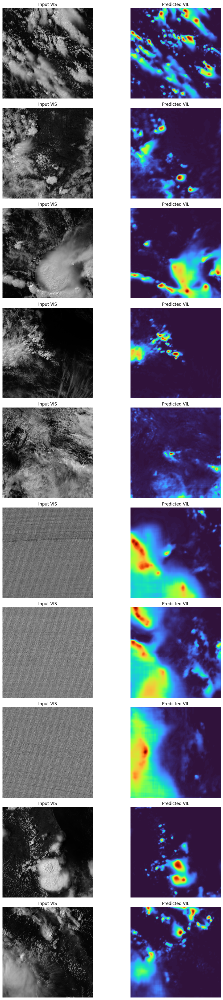

In [14]:
num_show = 10
indices = range(num_show)

fig, axes = plt.subplots(num_show, 2, figsize=(12, 4*num_show))

for j, idx in enumerate(indices):
    # input_vis has shape (384,384)
    input_vis = X[idx*36,:,:,0]* 0.85 * global_vis_max

    # pred_frame has shape (384,384)
    pred_frame = predictions[idx*36]

    axes[j, 0].imshow(input_vis, cmap="gray")
    axes[j, 0].set_title("Input VIS")
    axes[j, 0].axis("off")

    axes[j, 1].imshow(pred_frame, cmap="turbo")
    axes[j, 1].set_title("Predicted VIL")
    axes[j, 1].axis("off")

plt.tight_layout()
plt.show()



In [15]:
print(predictions.shape)

(360, 384, 384)


In [16]:
# 'predictions' has shape (360, 384, 384).
# Each batch of 36 frames belongs to one event, in the given order.
# Thus, the first 36 frames correspond to the first event ID,
# the next 36 frames to the second event ID, and so on.

event_ids = [
    "S852507", "S834438", "S847775", "S838836", "S851858",
    "S851835", "S849415", "S847917", "S855381", "S843625"
]

team_name = "Alberto"
frames_per_event = 36  # each event takes up 36 frames in 'predictions'
H, W = 384, 384        # spatial dimensions

for i, eid in enumerate(event_ids):
    # 1) Determine start/end indices in the predictions array
    start_idx = i * frames_per_event
    end_idx   = (i + 1) * frames_per_event  # end_idx is exclusive

    # 2) Extract the frames for the current event: shape (36, 384, 384)
    chunk = predictions[start_idx:end_idx]

    # 3) Transpose from (T, H, W) => (H, W, T) => (384, 384, 36)
    chunk_3d = np.transpose(chunk, (1, 2, 0))

    # 4) Ensure float32 dtype
    chunk_3d = chunk_3d.astype(np.float32)

    # 5) Create the output filename and save as .npy
    outfile = f"{team_name}-task2-vil-{eid}.npy"
    np.save(outfile, chunk_3d)
    print(f"Saved {outfile}, shape={chunk_3d.shape}, dtype={chunk_3d.dtype}")


Saved Alberto-task2-vil-S852507.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S834438.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S847775.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S838836.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S851858.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S851835.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S849415.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S847917.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S855381.npy, shape=(384, 384, 36), dtype=float32
Saved Alberto-task2-vil-S843625.npy, shape=(384, 384, 36), dtype=float32


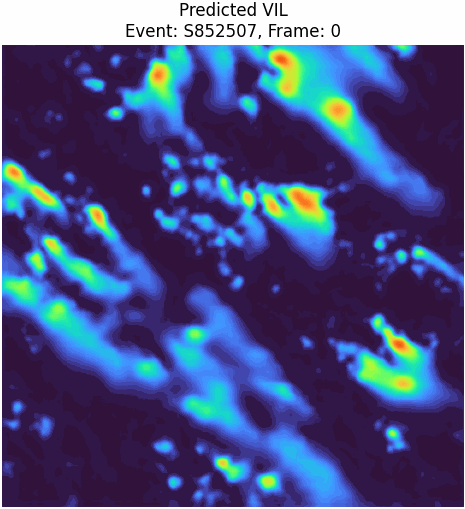

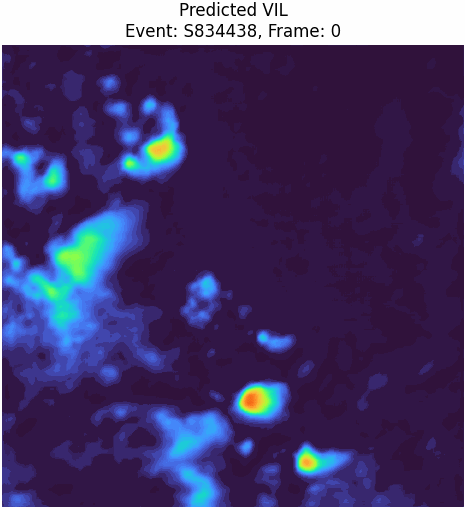

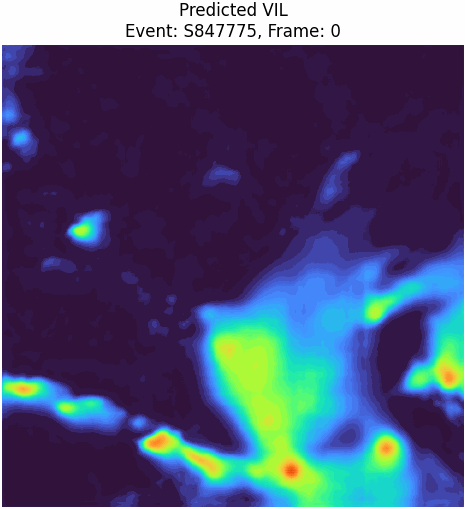

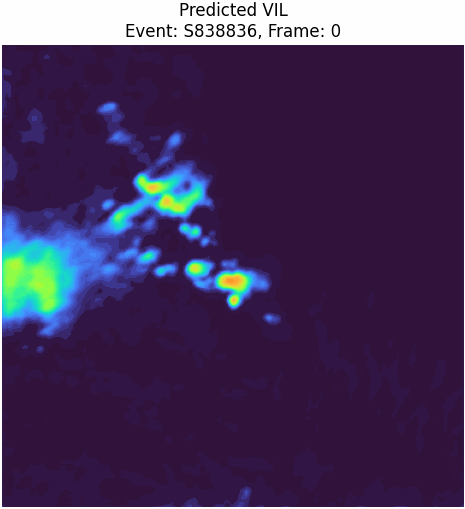

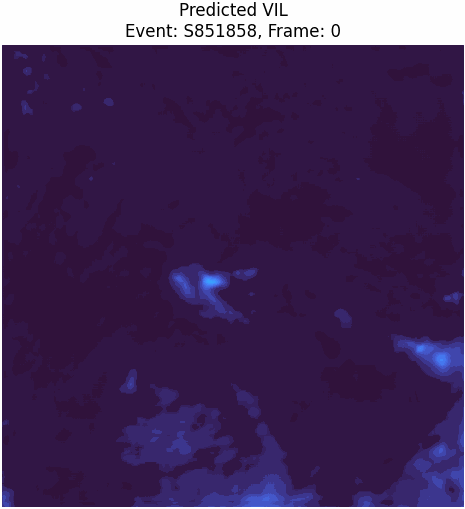

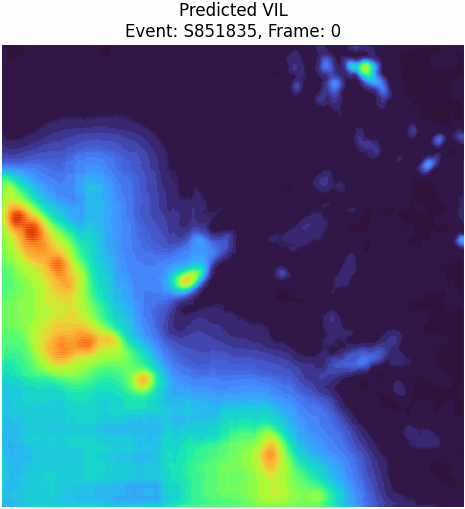

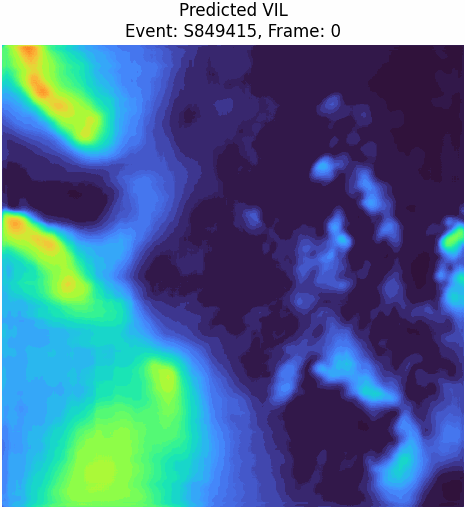

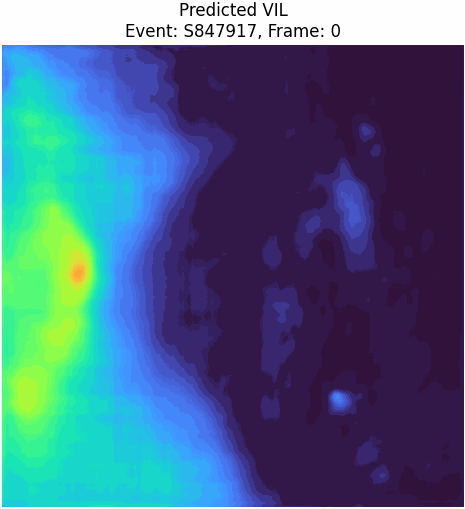

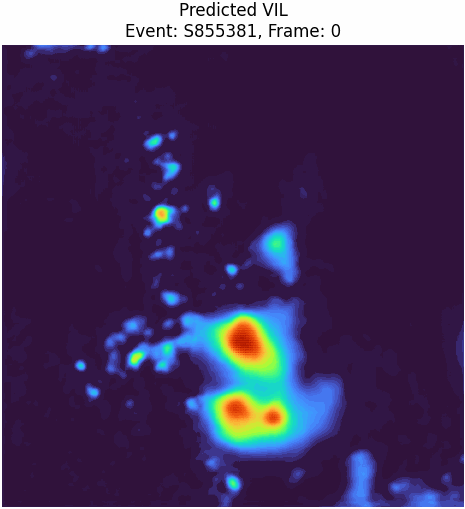

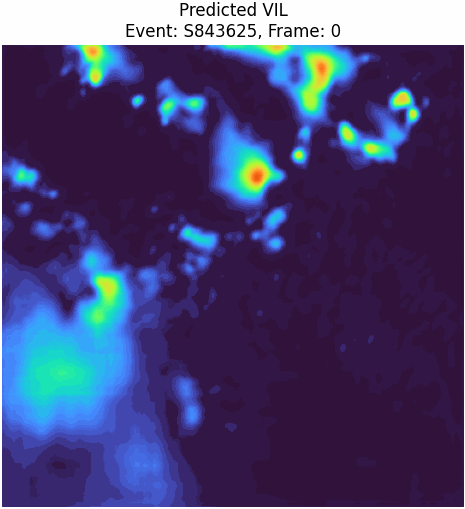

In [17]:
import os
import numpy as np
import matplotlib.pyplot as plt
import PIL
import IPython.display

event_ids = [
    "S852507","S834438","S847775","S838836","S851858",
    "S851835","S849415","S847917","S855381","S843625"
]
frames_per_event = 36

for i, eid in enumerate(event_ids):
    start_idx = i*frames_per_event
    end_idx   = (i+1)*frames_per_event

    # (36,384,384)
    chunk = predictions[start_idx:end_idx]

    # Transpose => (384,384,36)
    chunk_3d = np.transpose(chunk, (1,2,0)).astype(np.float32)

    # Visualization by GIF
    plot_predicted_vil(eid, chunk_3d, output_gif=True, save_gif=True)


## SUBMISSION CHECKER

In [18]:
def submission_checker(team_name, prediction_directory):
    """
    Checks only Task 2 submission files.
    Each file must have shape (384, 384, 36), dtype float32,
    and be named: <prediction_directory>/<team_name>-task2-vil-<event_id>.npy
    """

    import os
    import numpy as np

    # The 10 Task 2 event IDs
    task2_ids = [
        'S852507', 'S834438', 'S847775', 'S838836', 'S851858',
        'S851835', 'S849415', 'S847917', 'S855381', 'S843625'
    ]
    required_shape = (384, 384, 36)
    tag = "task2-vil"

    for event_id in task2_ids:
        # 1) Build the file path
        file = f"{prediction_directory.rstrip('/')}/{team_name}-{tag}-{event_id}.npy"

        # 2) Check file existence and load
        if not os.path.isfile(file):
            raise FileNotFoundError(f"ERROR: file not found: {file}")
        try:
            arr = np.load(file)
        except Exception as e:
            raise Exception(f"ERROR: unable to load {file} -> {e}")

        # 3) Verify shape
        if arr.shape != required_shape:
            raise ValueError(f"ERROR: {file} has wrong shape {arr.shape}, expected {required_shape}.")

        # 4) Verify dtype
        if arr.dtype != np.float32:
            raise TypeError(f"ERROR: {file} has wrong dtype {arr.dtype}, expected float32.")

    print("Task 2 submission files passed - please now upload them \U0001F600")

team_name = "Alberto"
prediction_directory = "/content/Task_2"

submission_checker(team_name, prediction_directory)

Task 2 submission files passed - please now upload them 😀
